

# Where should I open a Storage Facility?

The goal of this exercise "how US demographic trends influence the self-storage market and that PS can use this to make better investment decisions" &#x1F680;

Essentially, we are trying to understand what factors lead to consumer needing a additional space to store belongings. &#x1F9F3;&#x200D;


#### Approach
My approach is to first gather and process census data that I believe would impact the decision. The rationales behind choosing metrics and datasets are in the README page

Secondly, I will explore both modeling framewokrs: Regression and Classification

This attempts explores the classification method using Machine Learning libraries

Regression Model will be in development in near future but will be explored using PyMC. 


#### Metrics
Based on economic and additional context provided, I thought of the below metrics that could help us understand how these facrtors influence the self-storage market locations


| Metric | Definition | Usage | Source | 
| --- | --- | --- | --- |
| Population Per sqft | ratio of number of people per sqft | We want to look at this metric in 2 ways <br> First, by markets where there are currently storage spaces available.  | There are 2 sources for this metric <br> 1. We can use the <i>Area</i> field in the 'property locations.csv' field <br> 2. Census data to pull population of those locations 
| Migration Flow | This is number of people migrating in and out of counties and states | Breaking this down by city, county and states will help us understand relationship between number of people migrating and storage spaces available  | Source: [IRS GOV](https://www.irs.gov/statistics/soi-tax-stats-migration-data-2019-2020) 
| Median Value of Housing Unit | in dollars, median value of a housing unit | | Census.gov |


For the purpose of this exercise, scope is limited to evaluating difference in metrics with a Property Locations in a County vs time series of metrics

Equation we are formulating is 

$$ P(\text{Storage Location} | \text{Metrics}) = \frac{P(\text{Metrics} | \text{Storage Location}) \cdot P(\text{Metrics})}{P(\text{Storage Location})} $$


# Visualize Metrics by County on Map

In [129]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

counties["features"][0]

{'type': 'Feature',
 'properties': {'GEO_ID': '0500000US01001',
  'STATE': '01',
  'COUNTY': '001',
  'NAME': 'Autauga',
  'LSAD': 'County',
  'CENSUSAREA': 594.436},
 'geometry': {'type': 'Polygon',
  'coordinates': [[[-86.496774, 32.344437],
    [-86.717897, 32.402814],
    [-86.814912, 32.340803],
    [-86.890581, 32.502974],
    [-86.917595, 32.664169],
    [-86.71339, 32.661732],
    [-86.714219, 32.705694],
    [-86.413116, 32.707386],
    [-86.411172, 32.409937],
    [-86.496774, 32.344437]]]},
 'id': '01001'}

In [187]:
# Get latitude values from counties geojson file 
lat = []
county_fips = []
long = []

for i in range(len(counties["features"])):
    county_fips.append(counties["features"][i]["id"])
    county_coordinates = counties["features"][i]["geometry"]["coordinates"] 
    latitude_values = [coord[1] for coord in county_coordinates[0]]
    longitude_values = [coord[0] for coord in county_coordinates[0]]
    lat.append(latitude_values)
    long.append(longitude_values)


[[32.344437,
  32.402814,
  32.340803,
  32.502974,
  32.664169,
  32.661732,
  32.705694,
  32.707386,
  32.409937,
  32.344437],
 [33.765316,
  33.840617,
  33.815297,
  33.844862,
  33.844865,
  33.858221,
  33.909222,
  33.952059,
  34.05914,
  34.092654,
  34.119914,
  34.25437,
  34.259317,
  34.099073,
  33.986109,
  33.93977,
  33.940147,
  33.861706,
  33.801977,
  33.765316],
 [32.870525,
  32.772248,
  32.764211,
  32.746512,
  32.730731,
  32.72853,
  33.10734,
  33.108077,
  33.06258,
  33.055538,
  32.870525],
 [33.020566,
  32.929361,
  32.813899,
  32.75358,
  32.750591,
  32.707386,
  32.705694,
  32.661732,
  32.664169,
  32.663269,
  32.729532,
  32.837034,
  32.836264,
  33.049901,
  33.071861,
  33.070003,
  33.020566],
 [34.581703,
  34.587795,
  34.589215,
  34.724292,
  34.892202,
  34.88255,
  34.741239,
  34.832384,
  34.800022,
  34.767544,
  34.567081,
  34.581703],
 [31.619466,
  31.314973,
  31.246096,
  31.270889,
  31.195179,
  31.196349,
  31.617964,
  

In [205]:
import plotly.express as px

fig = px.choropleth_mapbox(census_with_storage, geojson=counties, locations='county_fips', color='Total_Population',
                           color_continuous_scale="Reds",
                           mapbox_style="carto-positron",
                           zoom=3, center={"lat": 37.0902, "lon": -95.7129},
                           opacity=0.8,
                           labels={'Total_Population': 'Total Population'}
                          )

fig.add_scattermapbox(
    lat=lat,
    lon=long,
    hoverinfo='text',
    customdata=census_with_storage[['storage_spaces']],
    hovertext='Storage Spaces Count: ' + census_with_storage['storage_spaces'].astype(str),
    marker={'color': 'blue', 'size': 5},
    name='Storage Spaces Count'
)

fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.show()


In [216]:
import plotly.express as px

fig = px.choropleth_mapbox(census_with_storage, geojson=counties, locations='county_fips', color='ap',
                           color_continuous_scale="inferno",
                           mapbox_style="carto-positron",
                           zoom=3, center={"lat": 37.0902, "lon": -95.7129},
                           opacity=0.8,
                           labels={'ap': 'Annual Payroll'}
                          )

fig.add_scattermapbox(
    lat=lat,
    lon=long,
    hoverinfo='text',
    customdata=census_with_storage[['ap']],
    hovertext='Storage Spaces Count: ' + census_with_storage['ap'].astype(str),
    marker={'color': 'blue', 'size': 5},
    name='Storage Spaces Count'
)

fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.show()


In [153]:
types_of_businesses_in_counties.fips.nunique()

3177

In [142]:
import plotly.graph_objects as go

fig = go.Figure()

fig.add_trace(go.Bar(x=census_with_storage['county_fips'], y=census_with_storage['Total_Population'], name='Total Population', opacity=0.9, marker_color='blue'))
fig.add_trace(go.Bar(x=census_with_storage['county_fips'], y=census_with_storage['storage_spaces'], name='Storage Spaces Count', opacity=0.9, marker_color='green'))
fig.update_layout(barmode='group')
fig.update_xaxes(title='County FIPS')
fig.update_yaxes(title='Count')
fig.show()

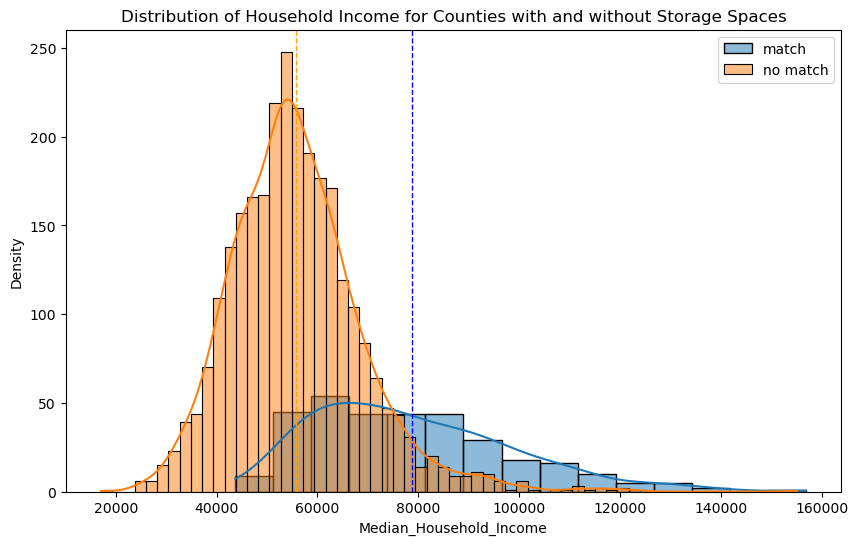

In [43]:
# Create a distribution plot of ap with a condition (match = 1); Create a distribution plot of ap with a condition (match = 0) and see if there is a difference; Plot labels of match and no match on the same plot
fig, ax = plt.subplots(figsize=(10, 6))
sns.histplot(modeling_df['Median_Household_Income'][modeling_df['match'] == 1], kde=True, label='match', ax=ax)
sns.histplot(modeling_df['Median_Household_Income'][modeling_df['match'] == 0], kde=True, label='no match', ax=ax)
plt.axvline(modeling_df['Median_Household_Income'][modeling_df['match'] == 1].mean(), color='blue', linestyle='dashed', linewidth=1)
plt.axvline(modeling_df['Median_Household_Income'][modeling_df['match'] == 0].mean(), color='orange', linestyle='dashed', linewidth=1)
plt.title('Distribution of Household Income for Counties with and without Storage Spaces')
plt.xlabel('Median_Household_Income')
plt.legend()
plt.ylabel('Density')
plt.show()

From the above chart we see that counties with storage spaces have a higher household income on average ($80,000) than counties without a storage space ($60,000)

In [44]:
int_cols = ['ap','emp','total_est','storage_spaces','births_2022','deaths_2022','domestic_migration_2022','international_migration_2022','Total_Population','Median_Household_Income','Median_Value_Housing_Unit']
modeling_df[int_cols] = modeling_df[int_cols].astype(int)

In [45]:
print(modeling_df['ap'][modeling_df['match'] == 1].describe(),modeling_df['ap'][modeling_df['match'] == 0].describe())

count         326.00
mean     18463139.94
std      32597148.77
min        372499.00
25%       3153432.00
50%       8965680.00
75%      19677995.50
max     304080571.00
Name: ap, dtype: float64 count       2769.00
mean      641145.10
std      1257006.25
min         1017.00
25%        76675.00
50%       226795.00
75%       606091.00
max     19607301.00
Name: ap, dtype: float64


In [46]:
modeling_df.drop(columns=['population_estimate_2022'],inplace=True)

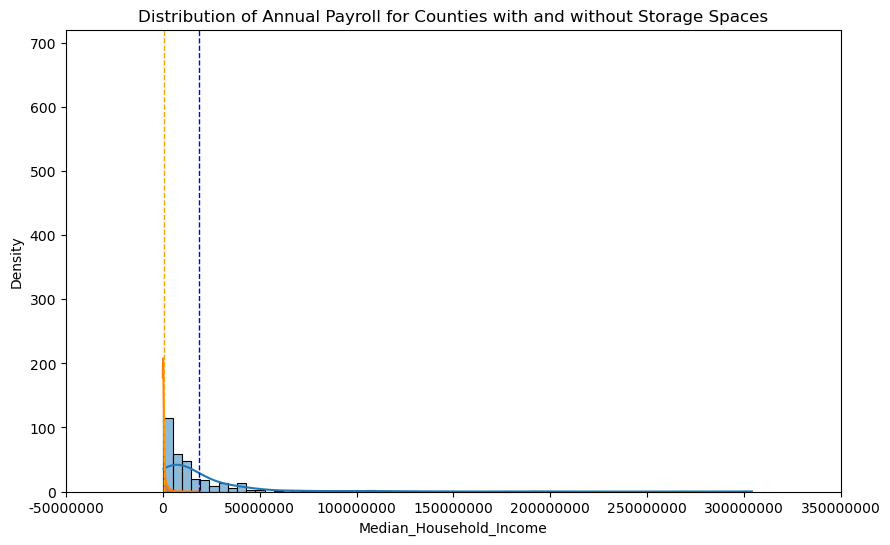

In [47]:
# Create a distribution plot of ap with a condition (match = 1); Create a distribution plot of ap with a condition (match = 0) and see if there is a difference; Plot labels of match and no match on the same plot
fig, ax = plt.subplots(figsize=(10, 6))
sns.histplot(modeling_df['ap'][modeling_df['match'] == 1], kde=True, label='match', ax=ax)
sns.histplot(modeling_df['ap'][modeling_df['match'] == 0], kde=True, label='no match', ax=ax)
plt.axvline(modeling_df['ap'][modeling_df['match'] == 1].mean(), color='blue', linestyle='dashed', linewidth=1)
plt.axvline(modeling_df['ap'][modeling_df['match'] == 0].mean(), color='orange', linestyle='dashed', linewidth=1)
plt.xticks(ticks=plt.xticks()[0], labels=[int(tick) for tick in plt.xticks()[0]])
plt.title('Distribution of Annual Payroll for Counties with and without Storage Spaces')
plt.xlabel('Median_Household_Income')
plt.ylabel('Density')
plt.show()

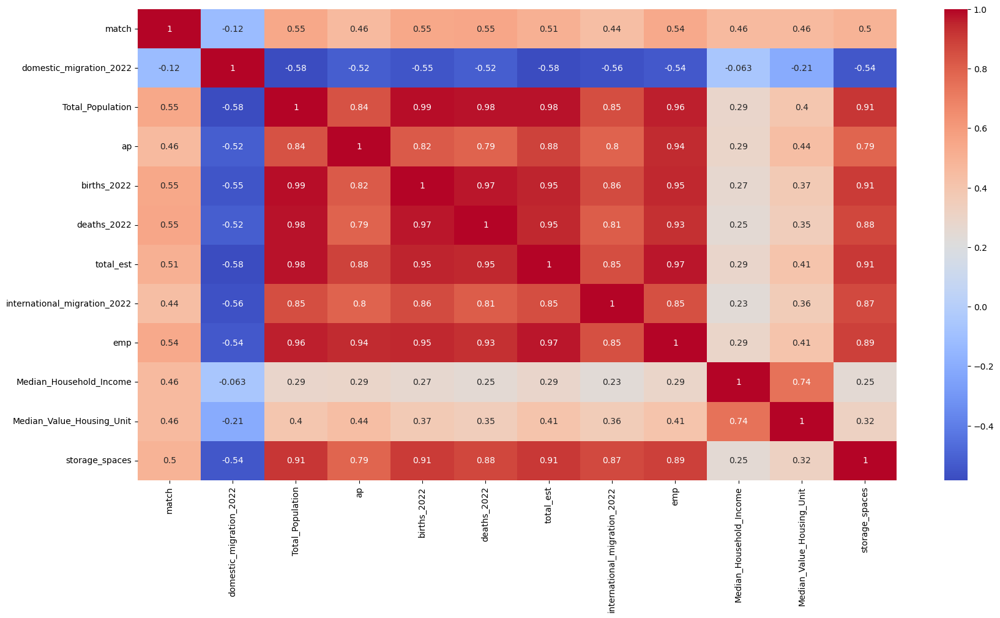

In [48]:
corr = modeling_df.corr()
plt.figure(figsize=(20,10))
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.show()

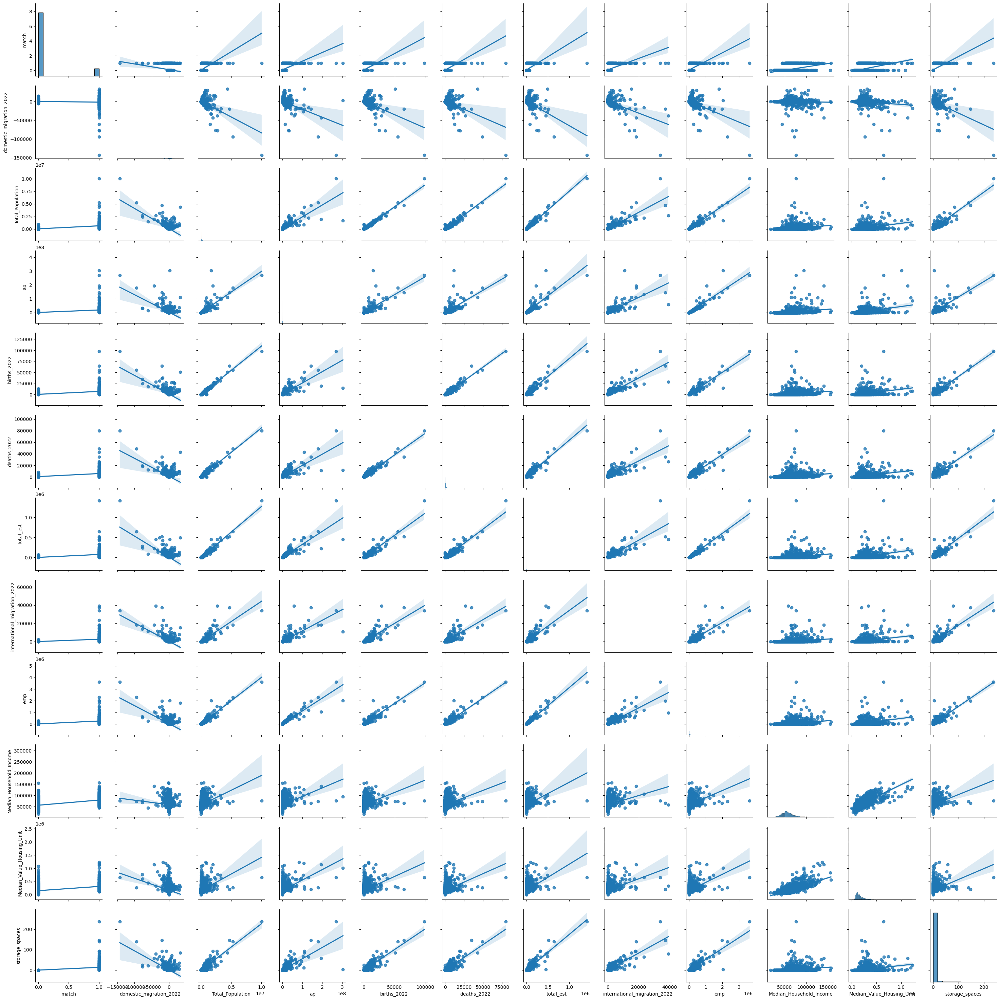

In [49]:
sns.pairplot(modeling_df, kind='reg')

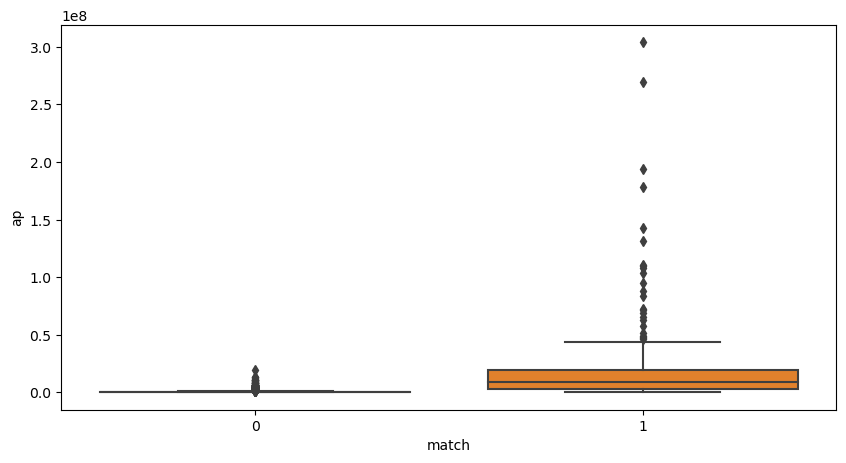

In [58]:
# Plot Annual Payroll conditioned on match
plt.figure(figsize=(10,5))
sns.boxplot(x='match', y='ap', data=modeling_df)
plt.show()

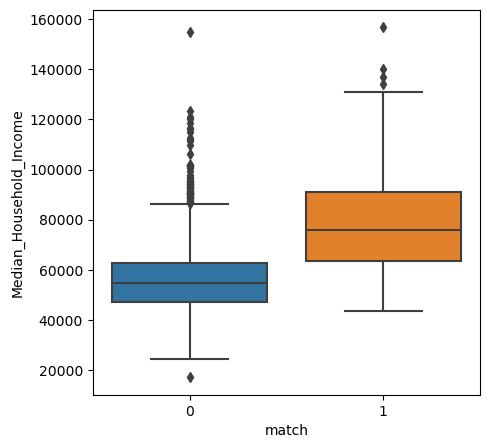

In [50]:
# Plot Annual Payroll conditioned on match
plt.figure(figsize=(5,5))
sns.boxplot(x='match', y='Median_Household_Income', data=modeling_df)
plt.show()

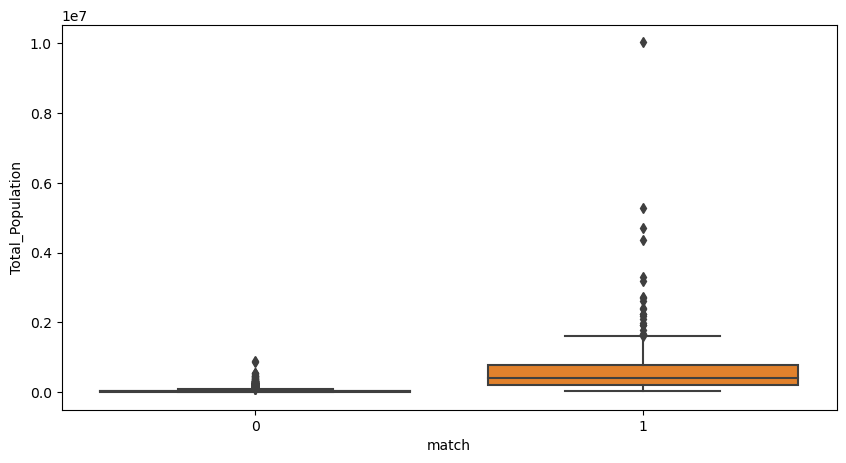

In [51]:
# Plot Population conditioned on match
plt.figure(figsize=(10,5))
sns.boxplot(x='match', y='Total_Population', data=modeling_df)
plt.show()

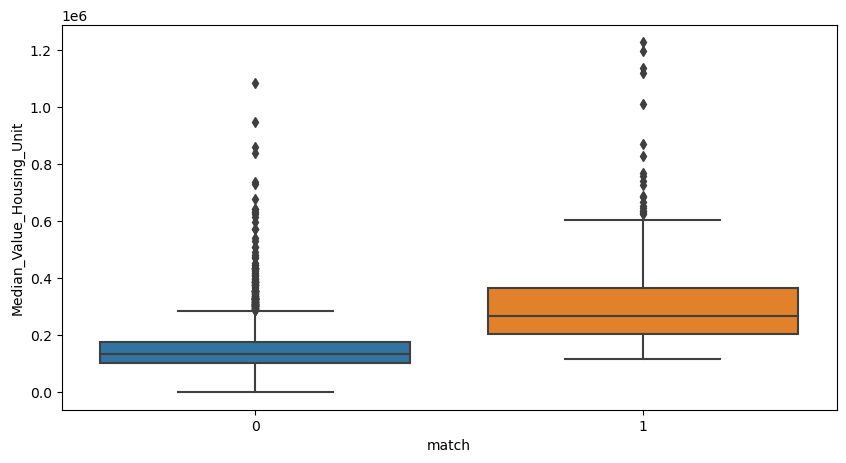

In [52]:
# Plot Median_Value_Housing_Unit conditioned on match
plt.figure(figsize=(10,5))
sns.boxplot(x='match', y='Median_Value_Housing_Unit', data=modeling_df)
plt.show()

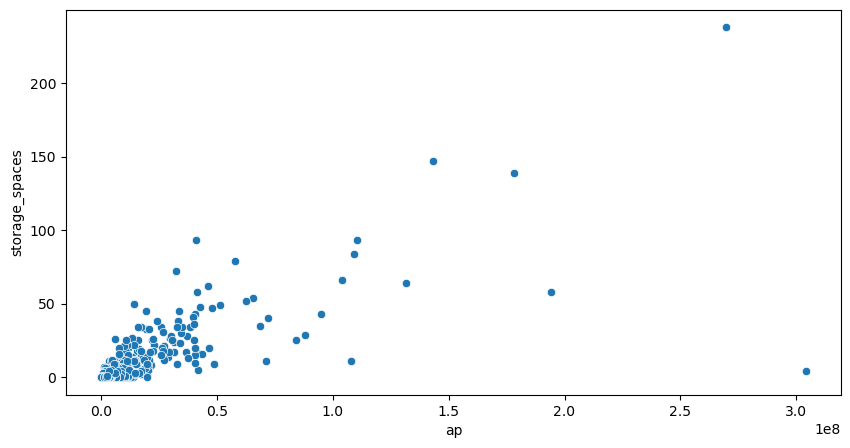

In [53]:
# Plot storage spaces against population
plt.figure(figsize=(10,5))
sns.scatterplot(x='ap', y='storage_spaces', data=modeling_df)
plt.show()